In [2]:
# import the required libraries and login to Hugging Face to download the model and use diffusers library
import logging
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from diffusers import StableDiffusionPipeline
from fastcore.all import concat
from huggingface_hub import notebook_login
from PIL import Image

logging.disable(logging.WARNING)

torch.manual_seed(1)
if not (Path.home()/'.cache/huggingface'/'token').exists(): notebook_login()

In [3]:
# Use Stable Diffusion Pipeline to do diffusion inference and generate images

pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", variant="fp16", torch_dtype=torch.float16).to("cuda")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

config.json: 0.00B [00:00, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

safety_checker/model.fp16.safetensors:   0%|          | 0.00/608M [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

scheduler_config-checkpoint.json:   0%|          | 0.00/209 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/1.72G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [3]:
# check if the model weights are cached
!ls ~/.cache/huggingface/hub

models--CompVis--stable-diffusion-v1-4


In [31]:
# Image generation prompt
prompt = "oil painting of a goat tied to a tree in the style of van gogh's starry night"

  0%|          | 0/50 [00:00<?, ?it/s]

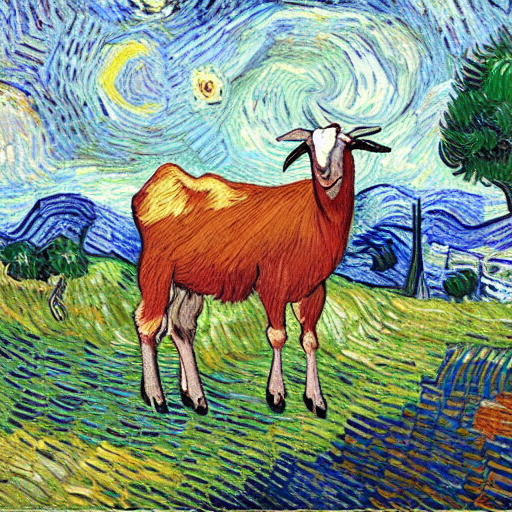

In [39]:
# pass the prompt to the pipe
pipe(prompt, guidance_scale = 7.5).images[0]

The inference runs for 50 steps because diffusion is a progressive denoising algorithm which takes a multi-step approach

  0%|          | 0/3 [00:00<?, ?it/s]

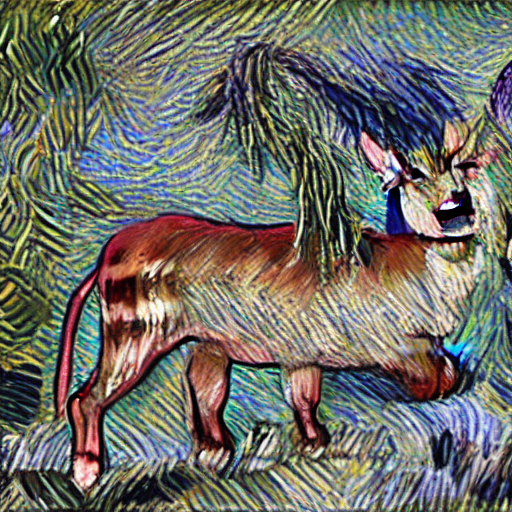

In [40]:
# reducing the inference steps to 3
pipe(prompt, num_inference_steps=3).images[0]

Reducing the inference steps, we see that the image is not good.it looks incomplete and we also see that the animal is close to deer

  0%|          | 0/100 [00:00<?, ?it/s]

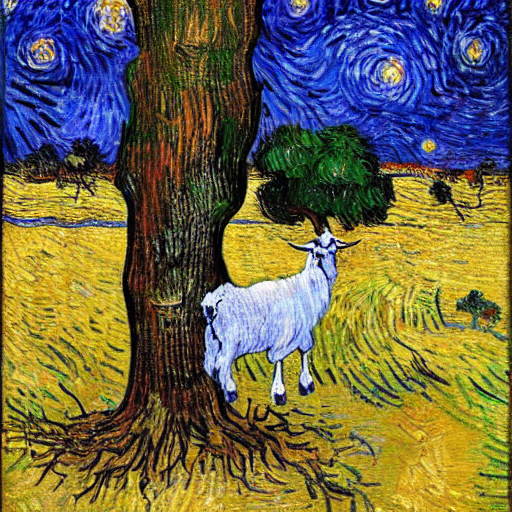

In [41]:

# increasing the inference_steps to 100
pipe(prompt, guidance_scale = 7.5, num_inference_steps=100).images[0]

Classifier free guidance:
Diffusion models by themselves generate images of different variety. Prompting the model makes it adhere to the prompt and restrict diversity of outputs. There is an option to make it flexible. A score is assigned instructing the model to adhere to the prompt partially.

In [37]:
def image_grid(images, rows, cols):
  w,h = images[0].size
  grid = Image.new('RGB', size=(w * cols, h * rows))
  for i, image in enumerate(images) : grid.paste(image, box=(i%cols * w, i//cols * h))
  return grid


In [42]:
num_rows, num_cols = 4,4 # 4X4 grid
prompts = [prompt] * num_cols

In [43]:
images = concat(pipe(prompts, guidance_scale = g).images for g in [1.1, 3, 7, 15])

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

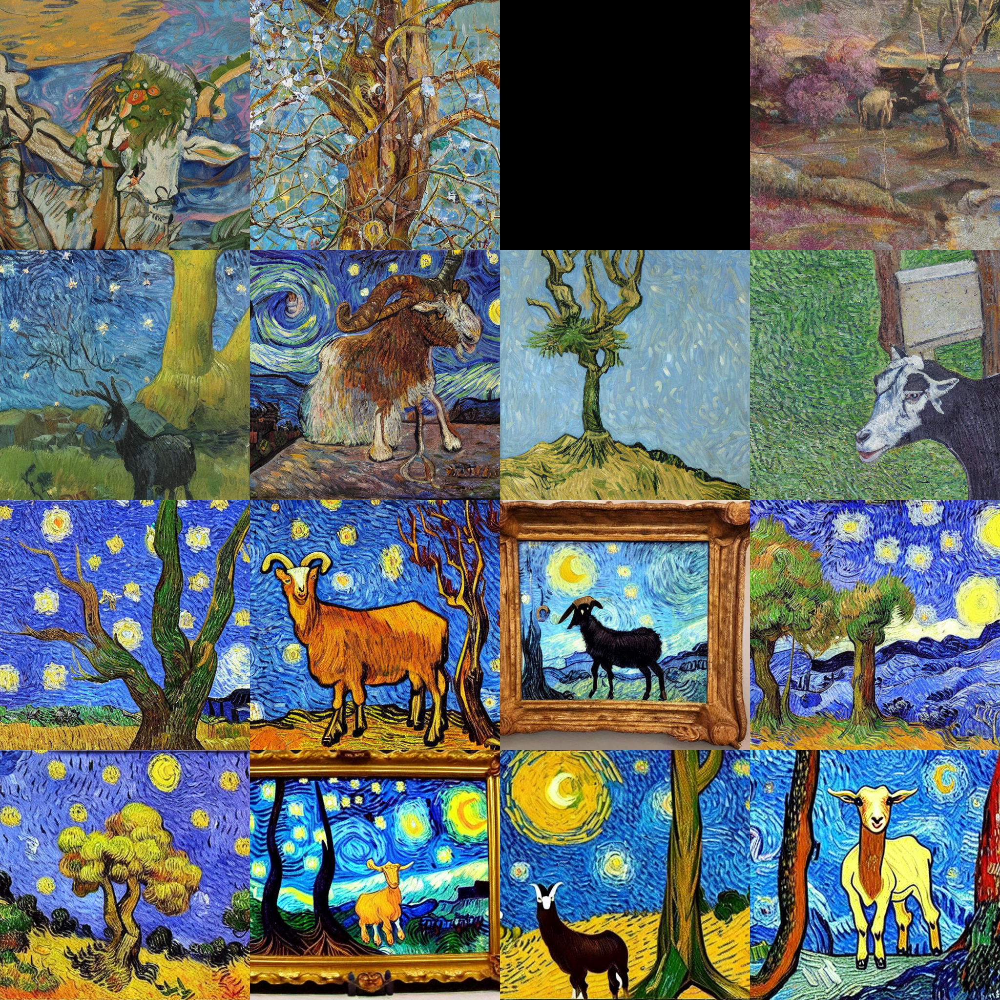

In [44]:
image_grid(images, num_rows, num_cols)

  0%|          | 0/50 [00:00<?, ?it/s]

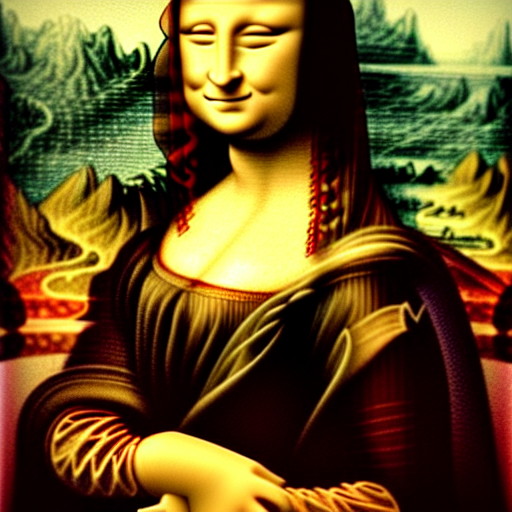

In [46]:
# negative prompting - to remove certain elements from the image through prompts
torch.manual_seed(42)
prompt = "Mona lisa in the style of Da Vinci"
pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

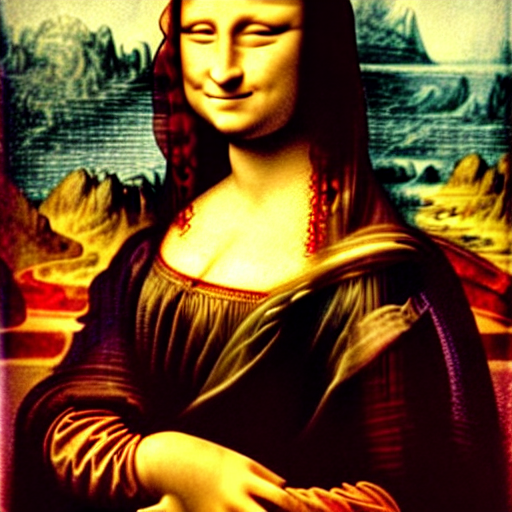

In [48]:
torch.manual_seed(42)
pipe(prompt, negative_prompt = "green").images[0]

Textual inversion : A very useful trick where a new word can be added to the text encoder's vocabulary so that with just some fine-tuning, the stable model' base diffusion model learns to use this new word and generate relevant images accordingly.

Already, the tokens have been trained by freezing the model weights keeping the text encoder alone learnable. We could just add this token with its embedding with the pipe's embeddings.

In [7]:
# download token embeddings learned on a bunch of indian water color paintings
!pip install fastdownload
from fastdownload import FastDownload
embeds_url = "https://huggingface.co/sd-concepts-library/indian-watercolor-portraits/resolve/main/learned_embeds.bin"
embeds_path = FastDownload().download(embeds_url)
embeds_dict = torch.load(str(embeds_path), map_location="cpu")

In [8]:
tokenizer = pipe.tokenizer
text_encoder = pipe.text_encoder


In [10]:
embeds_dict.keys()

dict_keys(['<watercolor-portrait>'])

the new token is 'watercolor-portrait'

In [11]:
new_token, new_token_embedding = next(iter(embeds_dict.items()))
new_token_embedding = new_token_embedding.to(text_encoder.dtype) # cast to text_encoder's datatype
print(new_token)

<watercolor-portrait>


In [12]:
assert tokenizer.add_tokens(new_token) == 1, "The token already exists!" # check if the token already exists

In [13]:
type(text_encoder)

transformers.models.clip.modeling_clip.CLIPTextModel

In [14]:
??text_encoder

In [15]:
new_token_embedding.dtype

torch.float16

In [16]:
new_token_embedding.shape

torch.Size([768])

In [25]:
text_encoder.get_input_embeddings().weight.shape

torch.Size([49408, 768])

In [27]:
len(tokenizer) # in tokenizer, the length is increased, but the embedding weights shape still is the old value

49409

In [29]:
text_encoder.resize_token_embeddings(len(tokenizer)) # increase embedding length to tokenizer length


Embedding(49409, 768)

In [30]:
text_encoder.get_input_embeddings().weight.shape # the shape should be changed to new tokenizer length

torch.Size([49409, 768])

In [31]:
new_token_id = tokenizer.convert_tokens_to_ids(new_token)
text_encoder.get_input_embeddings().weight.data[new_token_id] = new_token_embedding

  0%|          | 0/50 [00:00<?, ?it/s]

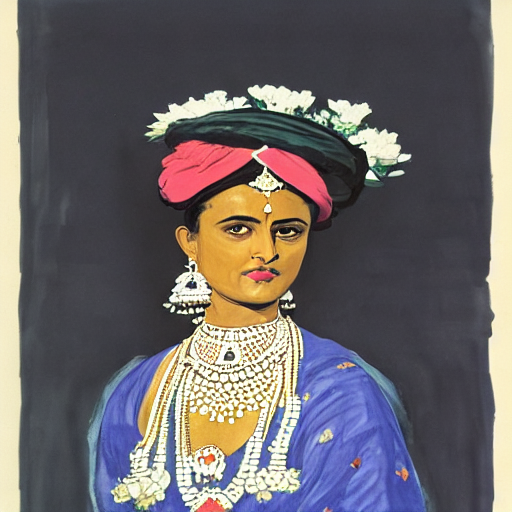

In [34]:
# with the new token added, we can use the word in the prompt for inference
prompt = "A woman playing in the style of <watercolor-portrait>."
pipe(prompt).images[0]

Dreambooth : A fine-tuning technique to add new capabilities to the trained model. Usually there are tokens which are not used much. So, we could use those tokens to map against some custom images so that usage of those tokens in the prompt conditions the generation of images closer to our custom images.

In [35]:
# a model has been finetuned to use sks token to generate images of Jeremy Howard
pipe = StableDiffusionPipeline.from_pretrained("pcuenq/jh_dreambooth_1000", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

model_index.json:   0%|          | 0.00/546 [00:00<?, ?B/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

safety_checker/model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/701 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

scheduler_config.json:   0%|          | 0.00/289 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/917 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/800 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/738 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

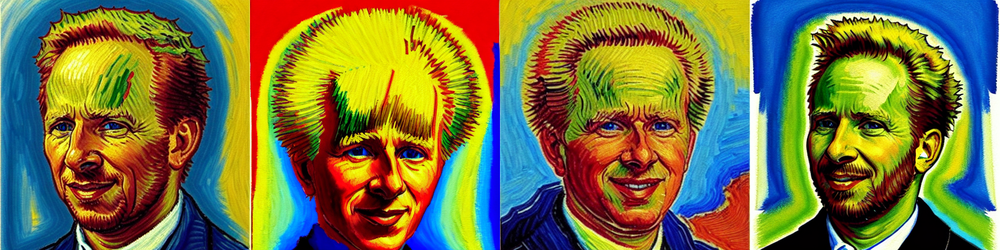

In [38]:
torch.manual_seed(1000)
# usage of sks conditions the model to generate Jeremy's image.
prompt = "Painting of sks person in the style of Van Gogh"
images = pipe(prompt, num_images_per_prompt=4).images
image_grid(images, 1, 4)